In [2]:
import os
import shutil
import zipfile
import random
import json

import matplotlib.pyplot as plt
import numpy as np
import cv2
import torch.nn as nn
import torchvision.transforms as transforms
from PIL import Image

from models import *
from utils import load_model_params

In [3]:
ROOT_DIR = #PATH_TO_AUGMENTED_DATASET_OUTPUTS
KVASIR_PATH = #PATH_TO_KVASIR-SEG_DATASET_ZIP
zf = zipfile.ZipFile(KVASIR_PATH)

In [20]:
if os.path.isdir(ROOT_DIR): # clean up existing dataset folder if one already exists
    shutil.rmtree(ROOT_DIR)
# create all the necessary auxilliary folders
os.mkdir(ROOT_DIR)
dataset_names = ["base", "augmented150", "augmented300"]
traintest = ["train", "test"]
class_names = ["masks", "polyps"]
for folder_outer in dataset_names:
    os.mkdir(os.path.join(ROOT_DIR, folder_outer))
    for folder_inner in traintest:
        os.mkdir(os.path.join(ROOT_DIR, folder_outer, folder_inner))
        for class_name in class_names:
            os.mkdir(os.path.join(ROOT_DIR, folder_outer, folder_inner, class_name))

In [21]:
# get list of paths to all images
im_paths = [fn for fn in zf.namelist() if fn.split(".")[-1] == "jpg" and fn.startswith("Kvasir-SEG/images")]
display(len(im_paths))

1000

In [22]:
# Randomly shuffle, then split into 300 test and 700 train images
random.shuffle(im_paths)
num_train = 700

# Copy the regular training images into each folder
for i, path in enumerate(im_paths):
    if i%50 == 0:
        print("Processing image %d/%d" % (i, len(im_paths)))
        
    # train or test
    if i < num_train:
        fidx = 0
    else:
        fidx = 1
        
    mask_data = zf.read(path.replace("images", "masks"))
    image_mask = cv2.imdecode(np.frombuffer(mask_data, np.uint8), 1)
    polyp_data = zf.read(path)
    image_polyp = cv2.imdecode(np.frombuffer(polyp_data, np.uint8), 1)
    
    # Need to copy base images to all 3 datasets
    for name in dataset_names:
        image_dst = os.path.join(ROOT_DIR, name, traintest[fidx], "polyps", str(i)+".jpg")
        mask_dst = os.path.join(ROOT_DIR, name, traintest[fidx], "masks", str(i)+".jpg")
        cv2.imwrite(mask_dst, image_mask)
        cv2.imwrite(image_dst, image_polyp)
    
    

Processing image 0/1000
Processing image 50/1000
Processing image 100/1000
Processing image 150/1000
Processing image 200/1000
Processing image 250/1000
Processing image 300/1000
Processing image 350/1000
Processing image 400/1000
Processing image 450/1000
Processing image 500/1000
Processing image 550/1000
Processing image 600/1000
Processing image 650/1000
Processing image 700/1000
Processing image 750/1000
Processing image 800/1000
Processing image 850/1000
Processing image 900/1000
Processing image 950/1000


Now with the regular dataset images added to all 3 datasets, now we augment two of them with 150 and 300 synthetic images respectively. To do this we select 30 healthy GI images from the full kvasir dataset, then for each choose 10 masks from the dataset and generate a synthetic image for each. Note that when we choose a mask we choose from a filtered list of masks (filtered by a cap on the polyp size in pixels, since the generator performs poorly when generating large polyps). Then we randomly apply a shift and mirroring on the mask to introduce slightly more variance.

In [10]:
# Max size is as a fraction of the screen space, i.e. 0.05 means at most 5% of the image is polyp region
def polyp_size_filter(path, max_size=0.025):
    mask_data = zf.read(path)
    image_mask = cv2.imdecode(np.frombuffer(mask_data, np.uint8), 1)
    size = np.sum(image_mask)/(255*np.prod(image_mask.shape))
    return size < max_size

# Loads a polyp mask at random from the list provided, then applies random flipping and shifting before returning the new
# mask (could do more complex transformations, BUT MUST RETAIN SHAPE)
def get_mask_from(filtered_paths):
    # Choose and load mask at random
    mask_path = filtered_paths[random.randrange(len(filtered_paths))]
    mask_data = zf.read(mask_path)
    image_mask = cv2.imdecode(np.frombuffer(mask_data, np.uint8), 1)
    
    # Apply random flipping
    if random.random() < 0.5:
        image_mask = cv2.flip(image_mask, 0) # vertical flip
    if random.random() < 0.5:
        image_mask = cv2.flip(image_mask, 1) # horizontal flip
        
    # Apply random shift
    shiftx = random.randrange(-30, 30)
    shifty = random.randrange(-30, 30)
    M = np.float32([[1,0,shiftx], [0,1,shifty]])
    image_mask = cv2.warpAffine(image_mask, M, (image_mask.shape[1], image_mask.shape[0]))
        
    return image_mask

In [11]:
# First, get filtered set of polyp masks
mask_paths = [fn for fn in zf.namelist() if fn.split(".")[-1] == "jpg" and fn.startswith("Kvasir-SEG/masks")]
mask_paths = [path for path in mask_paths if polyp_size_filter(path, max_size=0.04)]
display(len(mask_paths))

141

33 healthy images available


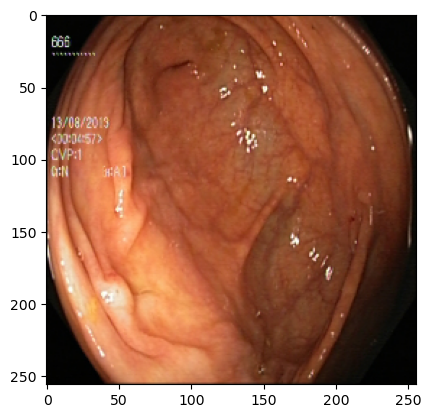

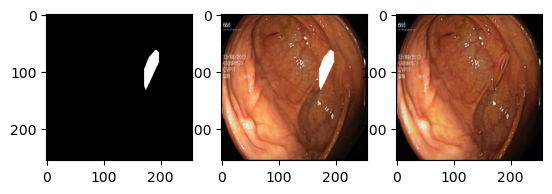

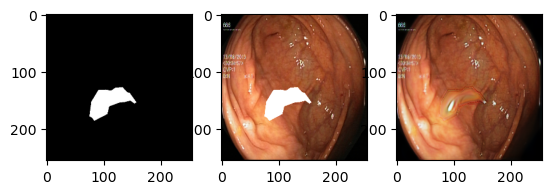

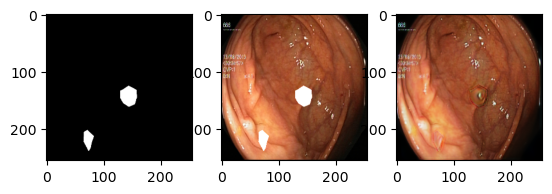

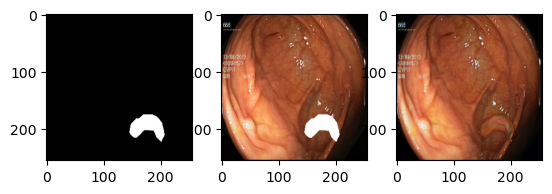

...

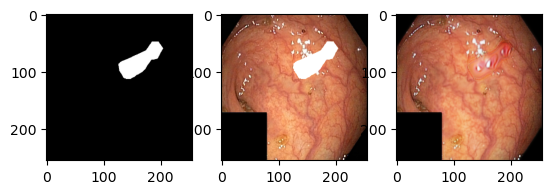

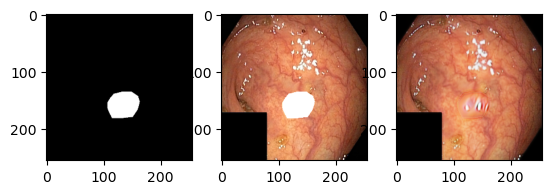

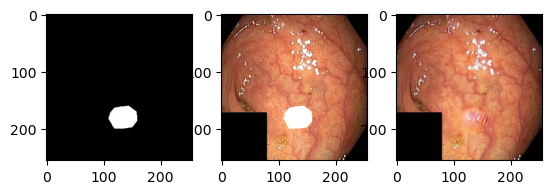

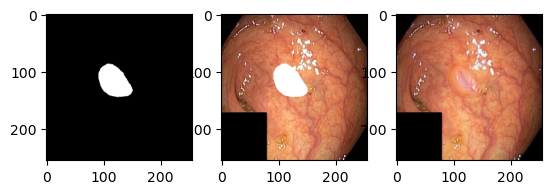

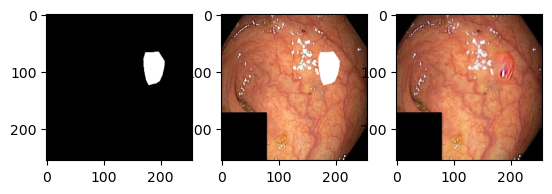

In [73]:
# Iterate over the 30 chosen healthy images from kvasir, and for each one create 10 synthetic images,
# saving the relevant mask and synthesised image in the training sets
healthy_images_dir = #PATH TO HEALTHY IMAGES FOLDER
healthy_image_paths = [os.path.join(healthy_images_dir, fn) for fn in os.listdir(healthy_images_dir) if fn.split(".")[-1] == "jpg"]
print("%d healthy images available" % len(healthy_image_paths))
assert len(healthy_image_paths) >= 33, "Need at least 33 healthy images"
random.shuffle(healthy_images_paths)

# First load the generator 
path_to_chosen = #PATH_TO_CHOSEN_MODEL_OUTPUT_FOLDER
fp = open(os.path.join(path_to_chosen, "training_options.json"))
training_options = json.load(fp)
#display(training_options)
if training_options["use_batch_norm"]:
    norm_layer = nn.BatchNorm2d
else:
    norm_layer = nn.InstanceNorm2d
if training_options["model"] == "pix2pix":
    generator = Pix2PixGenerator(norm_layer=norm_layer)
elif training_options["model"] == "cyclegan":
    generator = CycleGANGenerator(norm_layer=norm_layer)
elif training_options["model"] == "customA":
    generator = CustomGeneratorA(norm_layer=norm_layer)
elif training_options["model"] == "customB":
    generator = CustomGeneratorB(norm_layer=norm_layer)
else:
    raise Exception("The model %s is not recognised" % opt.model)
    
load_model_params(generator, os.path.join(path_to_chosen, "generator.pth"))

composite_transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)), # normalisation ganhack
])
to_pil = transforms.ToPILImage()

# Now actually perform the generation of synthetic images:
logging=True
for i in range(33):
    # get healthy image and mask:
    healthy_path = healthy_image_paths[i]
    healthy = cv2.cvtColor(cv2.imread(healthy_path), cv2.COLOR_BGR2RGB)
    healthy = cv2.resize(healthy, (256, 256))

    plt.imshow(healthy)
    plt.show()
    for j in range(10):
        mask = get_mask_from(mask_paths)
        mask = cv2.resize(mask, (256, 256))

        composite = Image.fromarray(cv2.add(healthy, mask))
        composite = composite_transform(composite)
        synthesised = generator(composite[None, ...])[0, ...]
        synthesised = to_pil((synthesised+1)/2)

        # save both images to augmented300 dataset
        synthetic_dst = os.path.join(ROOT_DIR, "augmented300", "train", "polyps", "synthetic"+str(i*10+j)+".jpg")
        mask_dst = os.path.join(ROOT_DIR, "augmented300", "train", "masks", "synthetic"+str(i*10+j)+".jpg")
        synthesised.save(synthetic_dst)
        cv2.imwrite(mask_dst, mask)
        
        # only save first 150 (180) images to augmented150
        if i<18:
            synthetic_dst = os.path.join(ROOT_DIR, "augmented150", "train", "polyps", "synthetic"+str(i*10+j)+".jpg")
            mask_dst = os.path.join(ROOT_DIR, "augmented150", "train", "masks", "synthetic"+str(i*10+j)+".jpg")
            synthesised.save(synthetic_dst)
            cv2.imwrite(mask_dst, mask)
            
        if logging:
            f, axes = plt.subplots(1,3)
            axes[0].imshow(mask)
            axes[1].imshow(to_pil((composite+1)/2))
            axes[2].imshow(synthesised)
            plt.show()
            
# NEED TO MAUALLY REMOVE 30 FROM EACH DATASET FOR PROBLEMATIC CASES SUCH AS POLY MASK OVERLAPPING WITH
# NON-EXISTANT BLACK CORNERS OF IMAGES